# Audio signal Processing Assignment 1

Team:
- Sanjaya Gunawardena
- Liyang Fang


### Loading the audio file

In [ ]:
from google.colab import files

# Upload the file
uploaded = files.upload()

Saving Bird_Plane_sound.wav to Bird_Plane_sound.wav


In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from scipy.io import wavfile
from scipy.fft import fft, fftfreq
from scipy.signal import butter, filtfilt, freqz

# Extract the filename from the uploaded dictionary
filename = next(iter(uploaded))

# Load the audio file
sample_rate, audio_data = wavfile.read(filename)

# Confirm the file is loaded
print(f"Loaded {filename} with sample rate {sample_rate} Hz and {len(audio_data)} samples.")


Loaded Bird_Plane_sound.wav with sample rate 48000 Hz and 1602560 samples.


In [ ]:
import IPython.display as ipd
ipd.Audio(audio_data, rate=sample_rate)

# Plot the time and frequency domain representations of the audio signal.

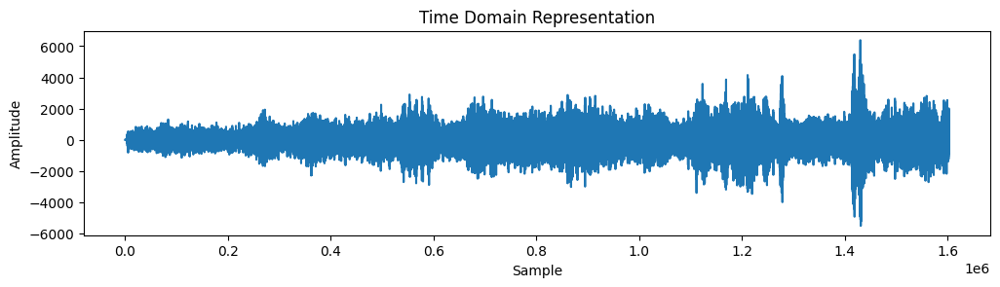

In [68]:
def plot_time(audio_data, sample_rate):
    # Time domain representation
    plt.figure(figsize=(12, 6))
    plt.subplot(2, 1, 1)
    plt.plot(audio_data)
    plt.title('Time Domain Representation')
    plt.xlabel('Sample')
    plt.ylabel('Amplitude')

def plot_frequency(audio_data, sample_rate):
    plt.figure(figsize=(12, 6))
    # Frequency domain representation
    N = len(audio_data)
    yf = fft(audio_data)
    xf = fftfreq(N, 1 / sample_rate)

    plt.subplot(2, 1, 2)
    plt.plot(xf, np.abs(yf))
    plt.title('Frequency Domain Representation')
    plt.xlabel('Frequency (Hz)')
    plt.ylabel('Magnitude')
    plt.xlim(0, sample_rate / 2)  # Focus on the positive frequencies
    plt.show()

plot_time(audio_data,sample_rate)

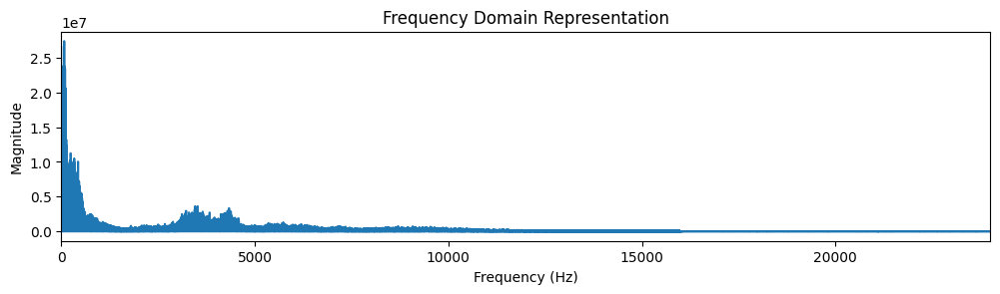

In [69]:
plot_frequency(audio_data,sample_rate)

Nyquist theoram

In [ ]:
nyquist_freq = sample_rate / 2
print("Nyquist Frequency:", nyquist_freq)

Nyquist Frequency: 24000.0


# Isolate Bird Sounds

In [ ]:
# Filter to capture the souond with Hz between 1000 and 8000
def bandpass_filter(signal, sample_rate, order, low_freq = 1000, high_freq = 8000):
    low = low_freq / nyquist_freq
    high = high_freq / nyquist_freq
    b, a = butter(order, [low, high], btype='bandpass')
    filtered_bird_signal = filtfilt(b, a, signal)
    return b, a, filtered_bird_signal

In [ ]:
# Plot the filtered signal
def plot_filtered_signal(b, a, sample_rate):
    w, h = freqz(b, a, worN=8000)
    plt.plot((sample_rate * 0.5 / np.pi) * w, abs(h), label=f"Order {len(b)-1}")

# Explore the effects of different filter orders on the filtered signal- Bandpass

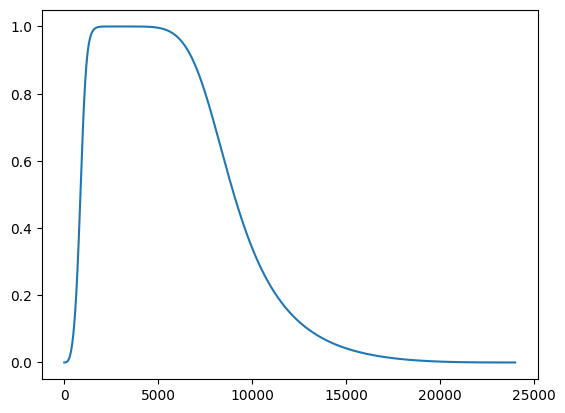

In [ ]:
# Plot the graph with order number = 3
b , a, filtered_bird_signal_3 = bandpass_filter(audio_data, sample_rate, order=3)
plot_filtered_signal(b, a, sample_rate)

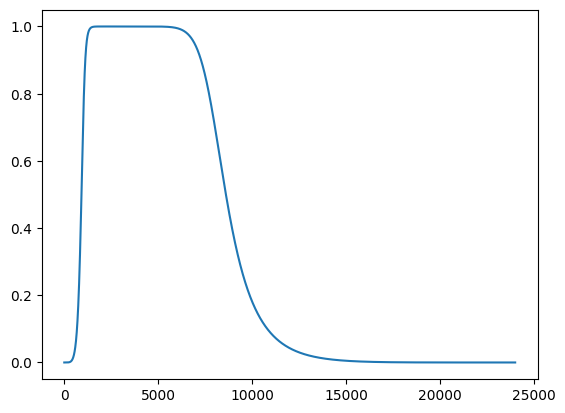

In [ ]:
# Plot the graph with order number = 5
b , a, filtered_bird_signal_5 = bandpass_filter(audio_data, sample_rate, order=5)
plot_filtered_signal(b, a, sample_rate)

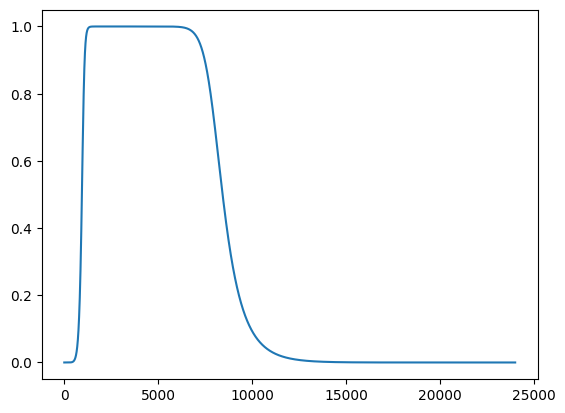

In [ ]:
# Plot the graph with order number = 7
b , a, filtered_bird_signal_7 = bandpass_filter(audio_data, sample_rate, order=7)
plot_filtered_signal(b, a, sample_rate)

In [ ]:
# To generate the filtered audio with order number = 3
wavfile.write('filtered_bird_signal_3.wav', sample_rate, filtered_bird_signal_3.astype(np.int16))
ipd.Audio('filtered_bird_signal_3.wav', rate=sample_rate)

In [ ]:
# To generate the filtered audio with order number = 5
wavfile.write('filtered_bird_signal_5.wav', sample_rate, filtered_bird_signal_5.astype(np.int16))
ipd.Audio('filtered_bird_signal_5.wav', rate=sample_rate)

In [ ]:
# To generate the filtered audio with order number = 7
wavfile.write('filtered_bird_signal_7.wav', sample_rate, filtered_bird_signal_7.astype(np.int16))
ipd.Audio('filtered_bird_signal_7.wav', rate=sample_rate)

# Overlay Filter Response on Signal FFT:Bandpass

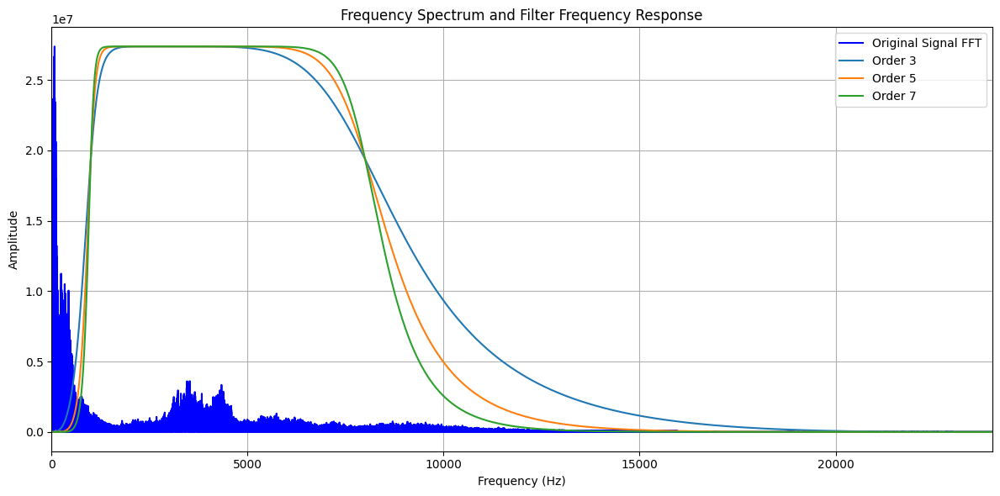

In [ ]:
orders = [3, 5, 7]

# Compute FFT of original signal
fft_original = np.fft.fft(audio_data)
freq_original = np.fft.fftfreq(len(audio_data), d=1/sample_rate)

# Plotting the signals and frequency responses
plt.figure(figsize=(12, 6))

# Plot original signal's FFT
plt.plot(freq_original, np.abs(fft_original), label='Original Signal FFT', color='blue')

# Plot frequency responses (amplitude) of the bandpass filters with different orders
for order in orders:
    b, a, filtered_audio = bandpass_filter(audio_data, sample_rate, order)
    w, h = freqz(b, a, worN=len(freq_original))
    plt.plot(sample_rate * 0.5 * w / np.pi, np.abs(h) * np.max(np.abs(fft_original)), label=f'Order {order}')

plt.title('Frequency Spectrum and Filter Frequency Response')
plt.xlabel('Frequency (Hz)')
plt.ylabel('Amplitude')
plt.legend()
plt.grid()
plt.xlim(0, sample_rate / 2)  # Show frequencies up to Nyquist frequency

plt.tight_layout()
plt.show()

# Isolate plane sound


In [ ]:
low_freq = 1000.0
high_freq = 8000.0

In [62]:
# Function to apply bandstop filter
def bandstop_filter(data, sample_rate, low_freq , high_freq, order):
    nyquist = nyquist_freq
    low = low_freq / nyquist
    high = high_freq / nyquist  # Normalizing the cutoff frequency
    b, a = butter(order, [low, high], btype='bandstop')
    y = filtfilt(b, a, data)
    return y, a, y

In [ ]:
# Function to save filtered audio files
def save_audio_file(filtered_signal, sample_rate, filename):
    wavfile.write(filename, sample_rate, filtered_signal.astype(np.int16))
    print(f"Filtered audio file saved as {filename}")
    return ipd.Audio(filename, rate=sample_rate)


In [ ]:
# Function to generate and display the plots
def plot_filter_responses_and_overlay(audio_data, sample_rate, low_freq, high_freq, order, btype='bandstop'):
    # Plot filter response
    nyquist = 0.5 * sample_rate
    low = low_freq / nyquist
    high = high_freq / nyquist
    b, a = butter(order, [low, high], btype=btype)
    w, h = freqz(b, a, worN=8000)

    plt.figure(figsize=(12, 6))
    plt.plot(0.5 * sample_rate * w / np.pi, np.abs(h), 'b')
    plt.title(f'{btype.capitalize()} Filter Frequency Response (order={order})')
    plt.xlabel('Frequency (Hz)')
    plt.ylabel('Gain')
    plt.grid()
    plt.show()

# Explore the effects of different filter orders on the filtered signal- Bandstop

Filtered audio file saved as filtered_plane_sounds_order_3.wav


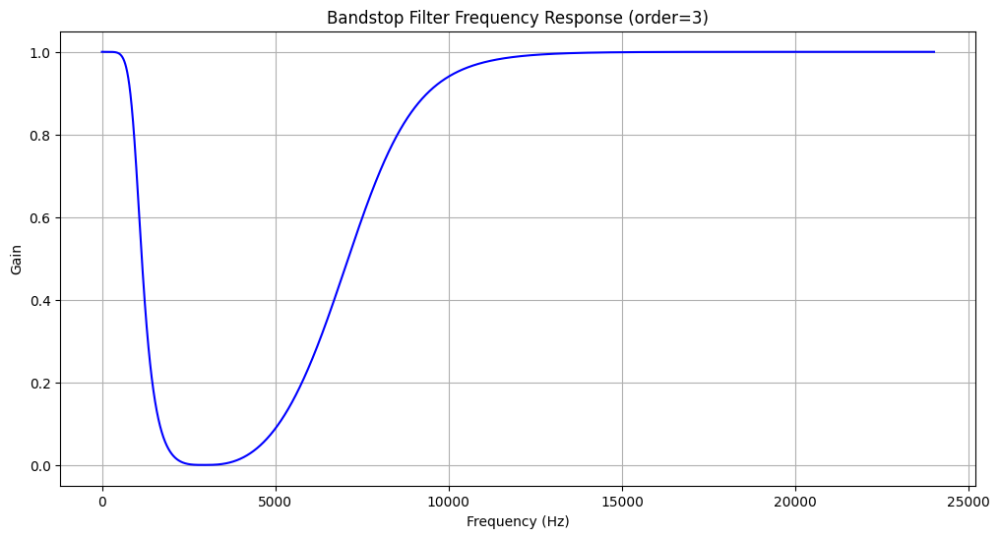

Filtered audio file saved as filtered_plane_sounds_order_5.wav


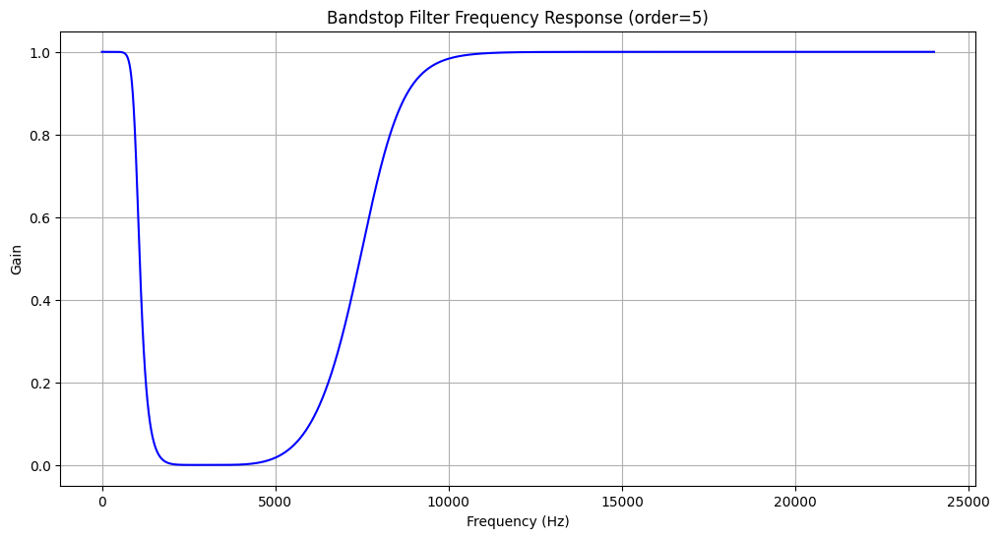

Filtered audio file saved as filtered_plane_sounds_order_7.wav


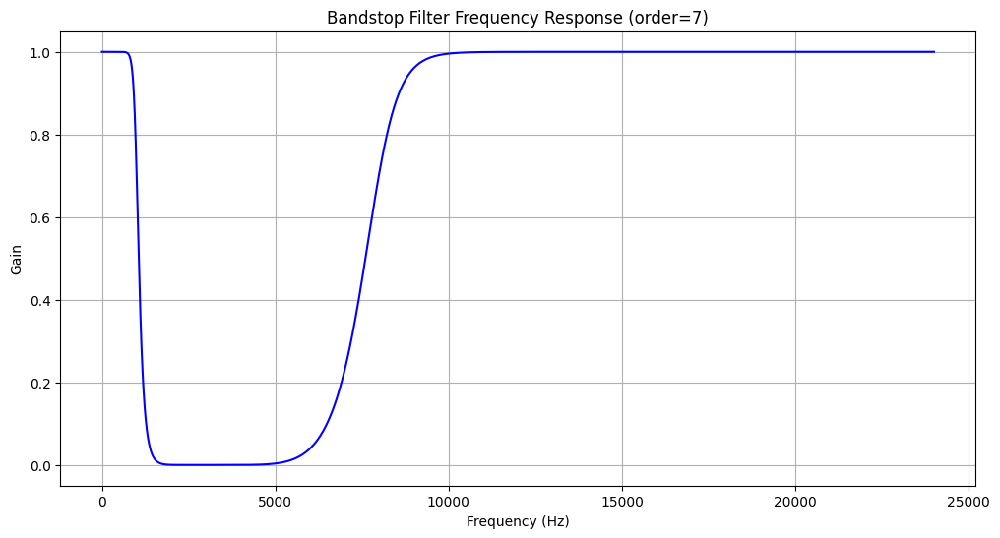

In [ ]:

# Filter orders to explore
filter_orders = [3, 5, 7]

# Apply bandstop filter, plot responses, and save audio files for each order
for order in filter_orders:
    # Apply bandstop filter
    filtered_plane_sounds = bandstop_filter(audio_data, sample_rate, low_freq, high_freq, order)

    # Save the filtered audio file
    output_filename = f'filtered_plane_sounds_order_{order}.wav'
    audio_output = save_audio_file(filtered_plane_sounds, sample_rate, output_filename)

    # Plot filter responses and overlay on signal FFT
    plot_filter_responses_and_overlay(audio_data, sample_rate, low_freq, high_freq, order, btype='bandstop')

    # Display the audio player
    display(audio_output)

# Overlay Filter Response on Signal FFT:Bandstop

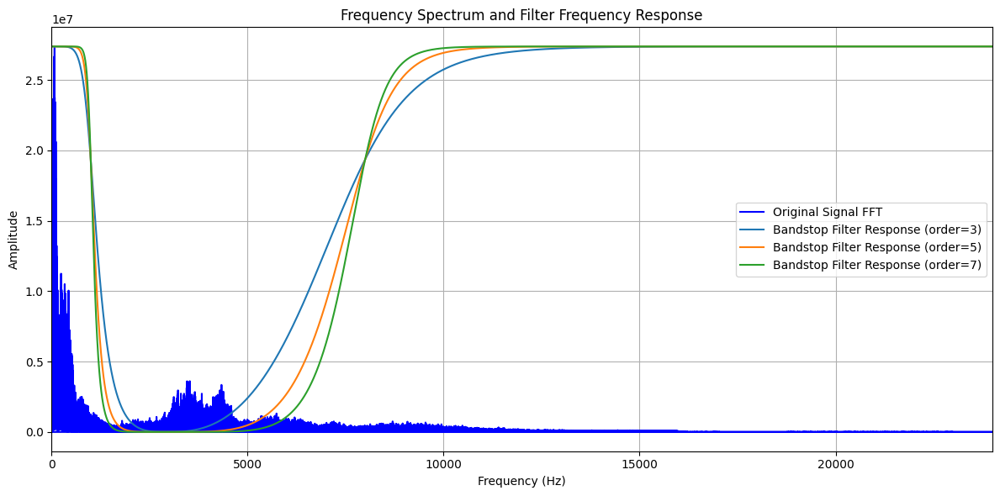

In [71]:
# Function to plot filter responses and overlay on signal FFT
def plot_filter_responses_and_overlay(audio_data, sample_rate, lowcut, highcut, orders, btype='bandstop'):
    # Compute FFT of the original signal
    N = len(audio_data)
    yf = fft(audio_data)
    xf = fftfreq(N, 1 / sample_rate)

    plt.figure(figsize=(12, 6))

    # Plot the original signal's FFT
    plt.plot(xf, np.abs(yf), label='Original Signal FFT', color='blue')

    nyquist = sample_rate / 2

    # Loop through each filter order
    for order in orders:
        low = lowcut / nyquist
        high = highcut / nyquist  # Normalizing the cutoff frequency
        b, a = butter(order, [low, high], btype=btype)
        w, h = freqz(b, a, worN=8000)

        # Plot the filter response
        plt.plot(sample_rate * 0.5 * w / np.pi, np.abs(h) * np.max(np.abs(yf)), label=f'{btype.capitalize()} Filter Response (order={order})')

    plt.title('Frequency Spectrum and Filter Frequency Response')
    plt.xlabel('Frequency (Hz)')
    plt.ylabel('Amplitude')
    plt.legend()
    plt.grid()
    plt.xlim(0, sample_rate / 2)  # Show frequencies up to Nyquist frequency

    plt.tight_layout()
    plt.show()

    # Plot filter responses and overlay on signal FFT (after filtering all orders)
plot_filter_responses_and_overlay(audio_data, sample_rate, low_freq, high_freq, filter_orders, btype='bandstop')